# Domain Analysis

This dataset appears to be a valuable resource for building machine learning models or conducting data analysis to assist in the differential diagnosis of erythemato-squamous diseases in dermatology. Researchers or practitioners may use this data to develop predictive models or gain insights into the relationships between clinical and histopathological features and the identified diseases. This dataset classifies skin diseases into 6 different types. The key summary of the given data are:


>Attributes: The dataset contains a total of 34 attributes. Of these, 33 are linear-valued (likely numerical) attributes, and one is nominal (likely categorical). But , all the data are encoded and are in integer format except for age, which is in object format.

>Diseases: The dataset focuses on the differential diagnosis of erythemato-squamous diseases, which include psoriasis, seborrheic dermatitis, lichen planus, pityriasis rosea, chronic dermatitis, and pityriasis rubra pilaris.

>Clinical Evaluation: Initially, patients were clinically evaluated using 12 features. These features may represent various clinical characteristics or symptoms associated with the diseases.

>Histopathological Evaluation: Skin samples were taken from the patients to evaluate 22 histopathological features. These features are likely related to the microscopic examination of skin tissue samples.

>Family History: There is a feature indicating family history, which has a binary value: 1 if any of these diseases have been observed in the family, and 0 otherwise.

>Age: The dataset includes an age feature representing the age of the patients.

>Degree of Features: For most of the features (both clinical and histopathological), values range from 0 to 3, where 0 indicates the feature was not present, 3 indicates the largest amount possible, and 1 or 2 indicate intermediate values. This suggests a degree of severity or presence for each feature.

>Patient Information: The dataset does not include patient names or ID numbers, likely for privacy reasons.



### The dependent variable(y) :

Class, is our dependent variable. Since the data set is encoded, class contains 6 types of skin diseases. Our job is to classify the erythemato-squamous disease in one of the following types:

-psoriasis 

-seboreic dermatitis

-lichen planus 

-pityriasis rosea

-cronic dermatitis

-pityriasis rubra pilaris


It is a muti class  classification problem.

### Business Goal

Our goal is to classify disorders into groups depending on its features. We are going to create a Machine Learning Model to classify the disorder in to 1 of the 6 categories. This model can then be used to help the doctors to make informed and quick decisions with their patients' ailments. 

### Benefits of the model

•	Improved accuracy and efficiency of diagnosis: The Machine learning model  created from this dataset can be trained on large datasets of skin images and clinical data to learn to identify the subtle features that distinguish between different types of skin disorders. This can lead to more accurate and efficient diagnosis, especially for rare or difficult-to-diagnose disorders.

•	Reduced reliance on expert clinicians: The machine learning model created can be used to provide preliminary diagnoses, which can then be reviewed and confirmed by expert clinicians. This can help to reduce the workload on clinicians and make it easier for patients to get access to early care.

•	Early detection and intervention: The model created can be used to identify skin conditions when they are most treatable. This can lead to better patient outcomes and reduced healthcare costs.

•	Personalized treatment recommendations: The machine learning model created can be used to analyze a patient's individual medical history and skin lesion characteristics to develop personalized treatment recommendations. This can help to improve the effectiveness and efficiency of treatment.

In [1]:
# import libraries
import pandas as pd
import numpy as np
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt
%matplotlib inline
import re
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Loading the dataset 
df = pd.read_csv("dataset_35_dermatology.csv")

# Basic Checks

In [3]:
df.head()

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,...,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age,class
0,2,2,0,3,0,0,0,0,1,0,...,0,0,3,0,0,0,1,0,55,2
1,3,3,3,2,1,0,0,0,1,1,...,0,0,0,0,0,0,1,0,8,1
2,2,1,2,3,1,3,0,3,0,0,...,0,2,3,2,0,0,2,3,26,3
3,2,2,2,0,0,0,0,0,3,2,...,3,0,0,0,0,0,3,0,40,1
4,2,3,2,2,2,2,0,2,0,0,...,2,3,2,3,0,0,2,3,45,3


In [4]:
df.shape

(366, 35)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 366 entries, 0 to 365
Data columns (total 35 columns):
 #   Column                                    Non-Null Count  Dtype 
---  ------                                    --------------  ----- 
 0   erythema                                  366 non-null    int64 
 1   scaling                                   366 non-null    int64 
 2   definite_borders                          366 non-null    int64 
 3   itching                                   366 non-null    int64 
 4   koebner_phenomenon                        366 non-null    int64 
 5   polygonal_papules                         366 non-null    int64 
 6   follicular_papules                        366 non-null    int64 
 7   oral_mucosal_involvement                  366 non-null    int64 
 8   knee_and_elbow_involvement                366 non-null    int64 
 9   scalp_involvement                         366 non-null    int64 
 10  family_history                            366 non-

In [6]:
df['class'].value_counts()

1    112
3     72
2     61
5     52
4     49
6     20
Name: class, dtype: int64

In [7]:
num_rows, num_columns = df.shape
print(f"Number of rows: {num_rows}")
print(f"Number of columns: {num_columns}")

Number of rows: 366
Number of columns: 35


In [8]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
erythema,366.0,2.068306,0.664753,0.0,2.0,2.0,2.0,3.0
scaling,366.0,1.795082,0.701527,0.0,1.0,2.0,2.0,3.0
definite_borders,366.0,1.549180,0.907525,0.0,1.0,2.0,2.0,3.0
itching,366.0,1.366120,1.138299,0.0,0.0,1.0,2.0,3.0
koebner_phenomenon,366.0,0.633880,0.908016,0.0,0.0,0.0,1.0,3.0
polygonal_papules,366.0,0.448087,0.957327,0.0,0.0,0.0,0.0,3.0
follicular_papules,366.0,0.166667,0.570588,0.0,0.0,0.0,0.0,3.0
oral_mucosal_involvement,366.0,0.377049,0.834147,0.0,0.0,0.0,0.0,3.0
knee_and_elbow_involvement,366.0,0.614754,0.982979,0.0,0.0,0.0,1.0,3.0
scalp_involvement,366.0,0.519126,0.905639,0.0,0.0,0.0,1.0,3.0


In [9]:
df.describe(include='O')

,Age
count,366
unique,61
top,40
freq,17


In [10]:
#Changing Age from object to Numeric datatype for better visualization
df['Age'] = pd.to_numeric(df['Age'], errors='coerce') 

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 366 entries, 0 to 365
Data columns (total 35 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   erythema                                  366 non-null    int64  
 1   scaling                                   366 non-null    int64  
 2   definite_borders                          366 non-null    int64  
 3   itching                                   366 non-null    int64  
 4   koebner_phenomenon                        366 non-null    int64  
 5   polygonal_papules                         366 non-null    int64  
 6   follicular_papules                        366 non-null    int64  
 7   oral_mucosal_involvement                  366 non-null    int64  
 8   knee_and_elbow_involvement                366 non-null    int64  
 9   scalp_involvement                         366 non-null    int64  
 10  family_history                        

# Exploratory Data Analysis

## Univariate Analysis

In [12]:
!pip install sweetviz


In [13]:
import sweetviz as sv #importing sweetviz library 
my_report = sv.analyze(df) #syntax to use sweetviz
my_report.show_html() #Default arguments will generate to "SWEETVIZ_REPORT.html"

                                             |                                             | [  0%]   00:00 ->…

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



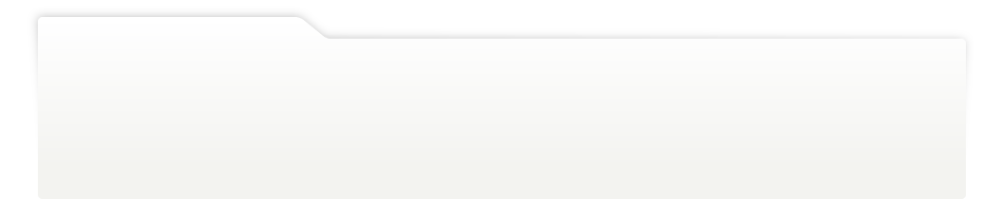
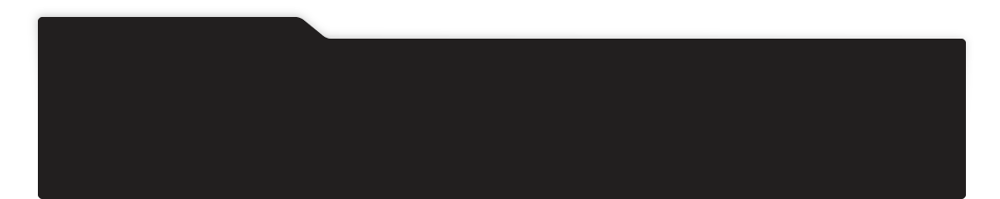
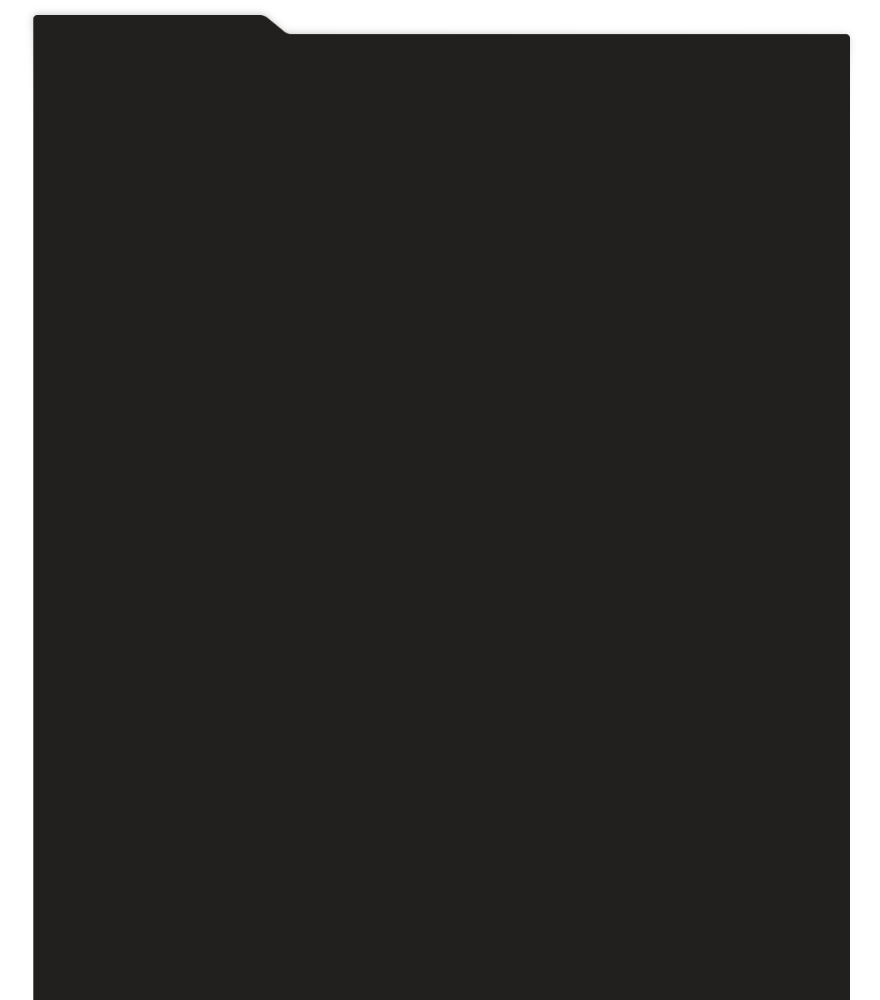
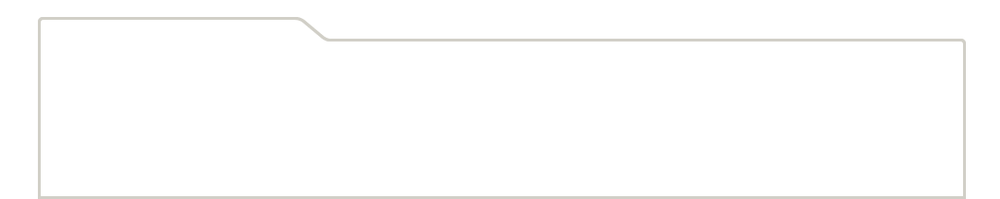
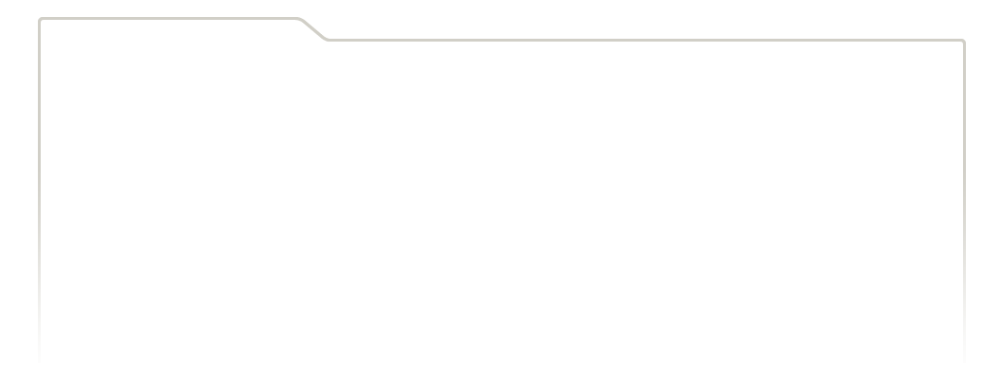
...
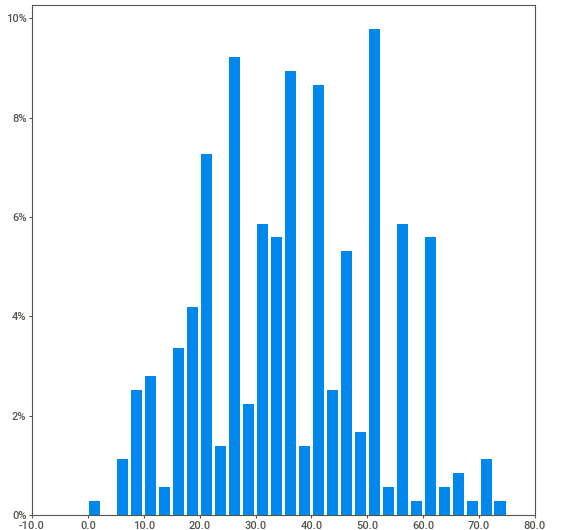
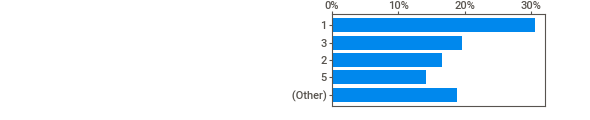
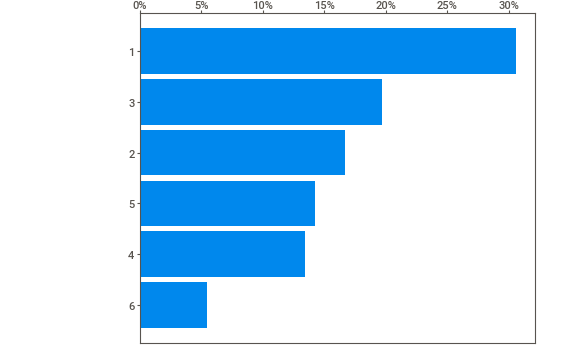
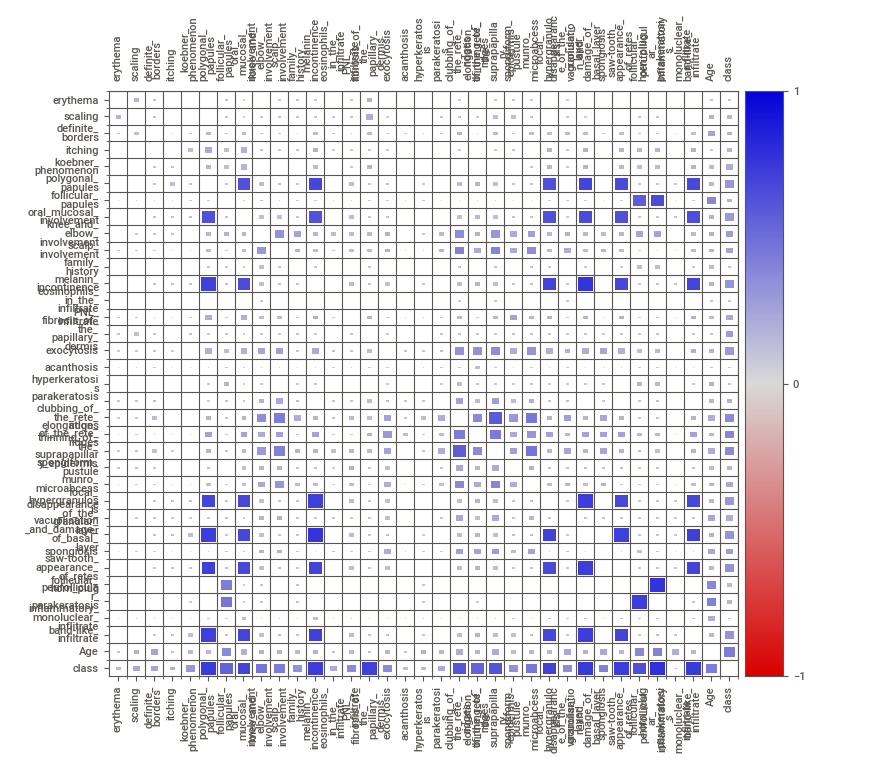
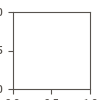

In [14]:
# incorporating sweetviz report in jupyter notebook
my_report.show_notebook()

In [15]:
numerical_summary = df.describe()
print("Summary statistics for numerical variables in df:\n", numerical_summary)

Summary statistics for numerical variables in df:
          erythema     scaling  definite_borders     itching  \
count  366.000000  366.000000        366.000000  366.000000   
mean     2.068306    1.795082          1.549180    1.366120   
std      0.664753    0.701527          0.907525    1.138299   
min      0.000000    0.000000          0.000000    0.000000   
25%      2.000000    1.000000          1.000000    0.000000   
50%      2.000000    2.000000          2.000000    1.000000   
75%      2.000000    2.000000          2.000000    2.000000   
max      3.000000    3.000000          3.000000    3.000000   

       koebner_phenomenon  polygonal_papules  follicular_papules  \
count          366.000000         366.000000          366.000000   
mean             0.633880           0.448087            0.166667   
std              0.908016           0.957327            0.570588   
min              0.000000           0.000000            0.000000   
25%              0.000000           0.000

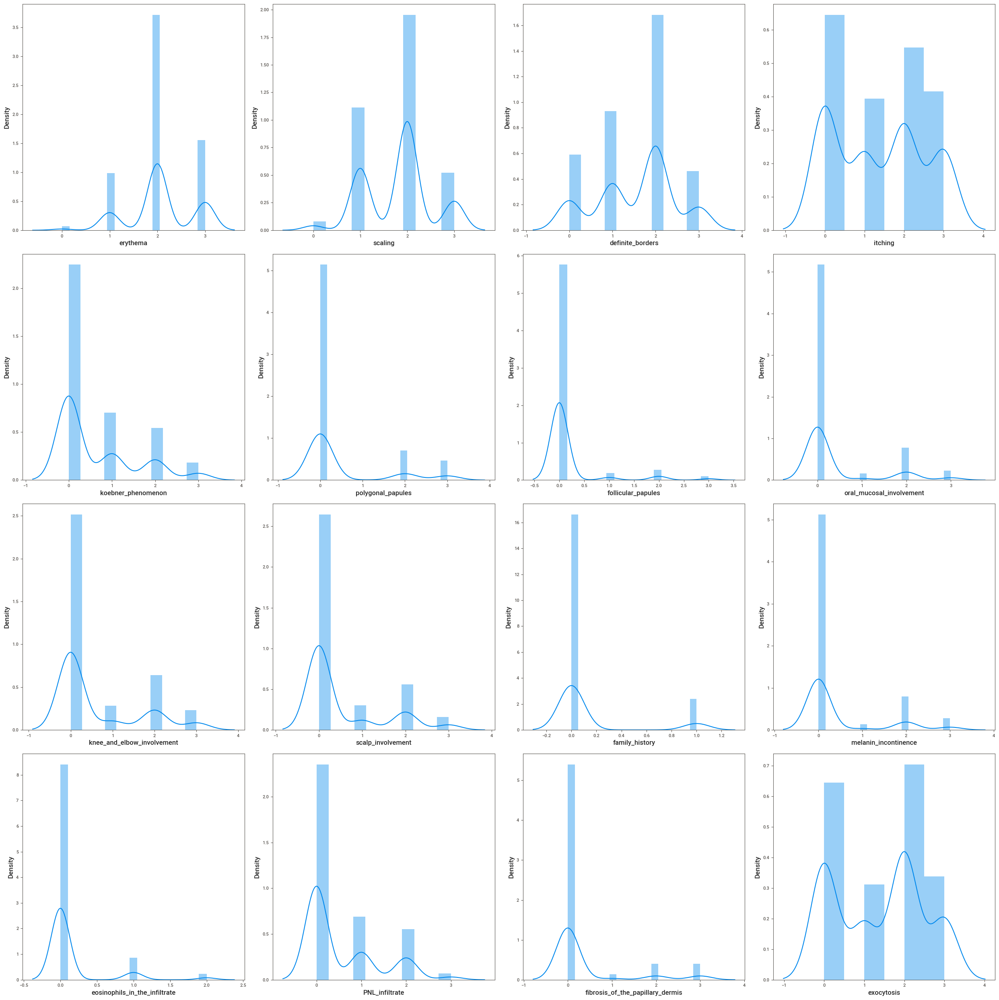

In [16]:
df1=df.iloc[:,:16]
plt.figure(figsize=(25,25),facecolor='white')
plotnum=1
for c in df1:
    if(plotnum<17):
        ax=plt.subplot(4,4,plotnum)
        sns.distplot(df1[c])
    plotnum+=1
plt.tight_layout()   

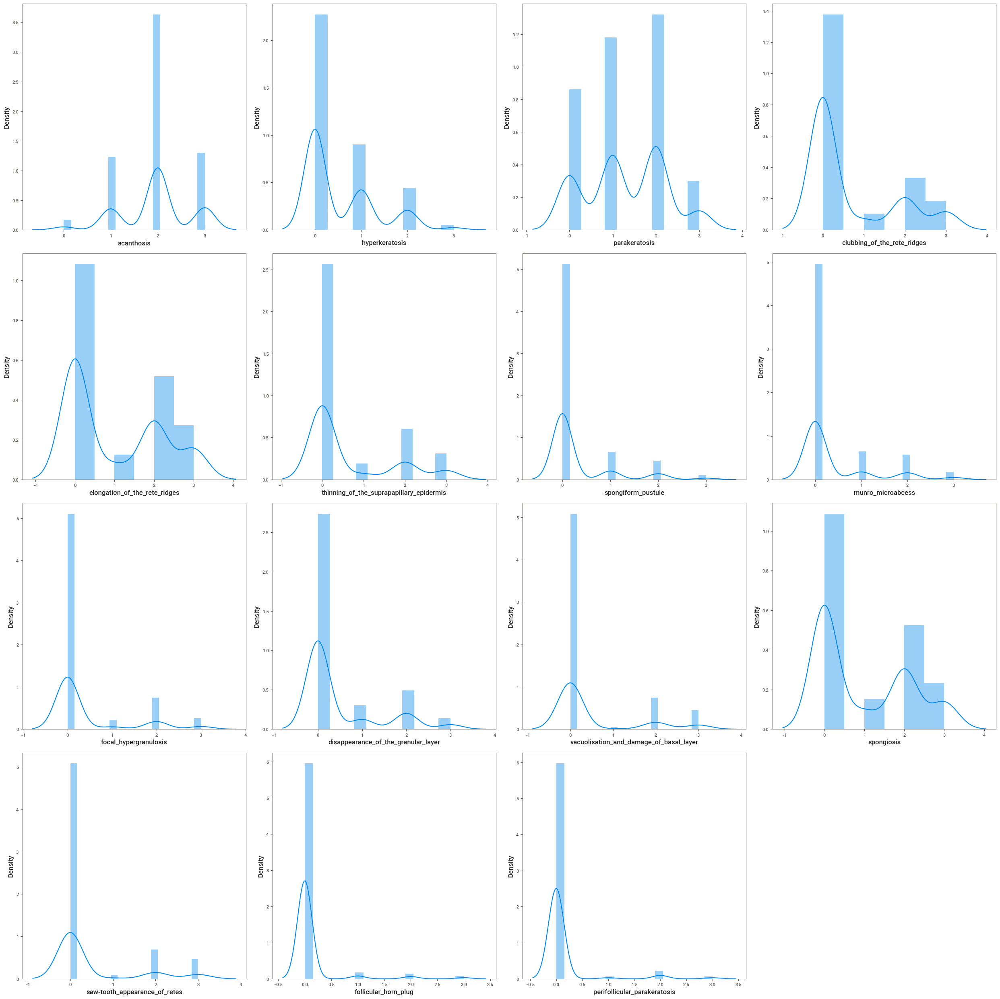

In [17]:
df2=df.iloc[:,16:31]
plt.figure(figsize=(25,25),facecolor='white')
plotnum=1
for c in df2:
    if(plotnum<16):
        ax=plt.subplot(4,4,plotnum)
        sns.distplot(df2[c])
    plotnum+=1
plt.tight_layout()   

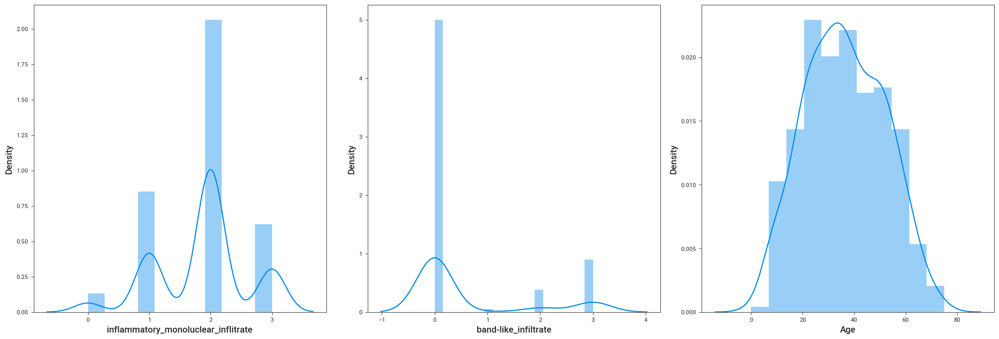

In [18]:
df3=df.iloc[:,31:34]
plt.figure(figsize=(25,25),facecolor='white')
plotnum=1
for c in df3:
    if(plotnum<16):
        ax=plt.subplot(4,4,plotnum)
        sns.distplot(df3[c])
    plotnum+=1
plt.tight_layout()  

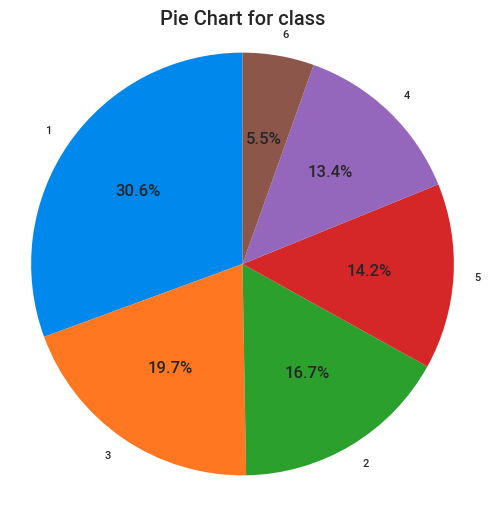

In [19]:
class_column = 'class'

# Calculate the counts of each unique value in the 'class' column
class_counts = df[class_column].value_counts()

# Create a pie chart
plt.figure(figsize=(6, 6))  # Adjust the figure size as needed
plt.pie(class_counts, labels=class_counts.index, autopct='%1.1f%%', startangle=90)
plt.title(f'Pie Chart for {class_column}')
plt.axis('equal')  # Equal aspect ratio ensures that the pie chart is circular
plt.show()

### Insights from Univariate Analysis

- In 59% data, erythema was present at degree 2(higher side). erythema was 0( or not present at all) only for 1% of cases
- Scaling was present in 53% of cases at degree 2(higher side). erythema was 0( or not present at all) only for 2% of cases
- 46% of cases have definite border at degree 2(higher intermediate).Only 13% cases have highest degree (value 3)of definite       border.
- 32% of cases do not have itching whereas 21% have severe itching.
- 61% cases didnt report any keobner phenomenon.
- nearly 81% cases didnt have any polygonal papules. 7% had polygonal papules at highest degree.
- 91% cases didnt have any follicular papules.  only 2% had highest degree of follicular papules.
- 82% cases didn't have any oral mucosal involvement. only 2% had highest degree of oral mucosal involvement.
- 69% cases didn't have any knee and elbow involvement whereas 6% cases were reported with highest degree of knee and elbow       involvement.
- 72% cases didn't have anyinvolvement wher scalp whereas 4% cases were reported with highest degree of scalp involvement.
- 87% cases didnt have any family history of skin disroders
- 81% didn't have melanin incontinence while 4% cases had extreme cases of melanin incontinence.
- 89% cases didn't have eosinophils in the infiltrate while no cases recorded highest degree of eosinophils in the infiltrate.
- 64% didn't have any PNL infiltrate while 2% had severe PNL infiltrate.
- 85% didn't have any fibrosis of the papillary dermis while 6% reported severe cases of fibrosis of the papillary dermis.
- 129 cases (35%) reported exocytosis of higher grade(value 2) while was the least was degree 1 in 16% cases.
- 57% reported acanthosis of degree 2. 20% reported acanthosis of degree 3.
- Hyperkeratosis was not seen in 62% of cases while 1% experienced highest degree of hyperkeratosis.
- 8% had parakeratosis of highest dregree. It was not seen in 23% of cases.
- 69% cases didn't have any clubbing of the rete ridges.9% had it severley.
- 54% didn't have any elongation of rete ridges while 14% had it in the highest degree.
- 70% casses didnt have any thinning of suprapapillary epidermis while 8% has it in severity.
- spongiform pustule was not seen in 81% of cases while 2% had it in highest degree.
- muncro microabcess was not present in 78% of cases.  3% had it in highest degree.
- 81% cases didnt experience focal hypergranulosis . 4% had it in highest severity.
- disappearance of granular layer didn't occur in 75% cases while granular layer disappeared in highest degree in 4% of cases.
- in 80% of cases, vacuolisation and damage of basal layer didn't occur. It occurred at highest degree in  only 7% of the cases.
- 54% cases didn't have spongiosis. 12% had spongiosis in highest severity.
- 80% cases didn't see tooth appearance of retes. 7& cases saw it in severe level.
- 94% cases didn't have any follicular horn plug.
- perifollicular parakeratosis was not seen in 94% of cases.
- inflammatory monoluclear infiltrate was seen in 56% of cases at degree 2. 4% didn't report it.
- 79%  cases didn't have any band like infiltrate. 14%  had it in highest order of 3.
- Maximum patients fell in age group of 30 to 40 years.
- From Pie chart we can see that maximum cases are for disease class 1 followed by class 3. Lowest is disease class 6.



## Bivariate Analysis

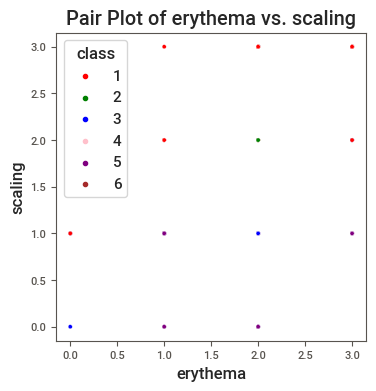

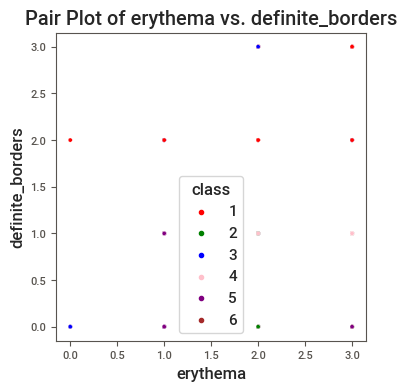

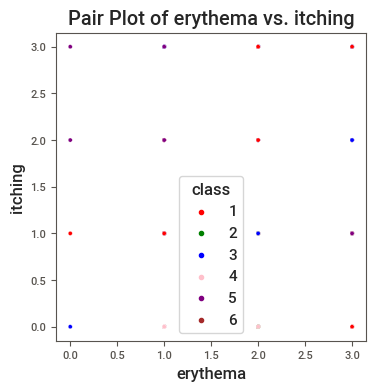

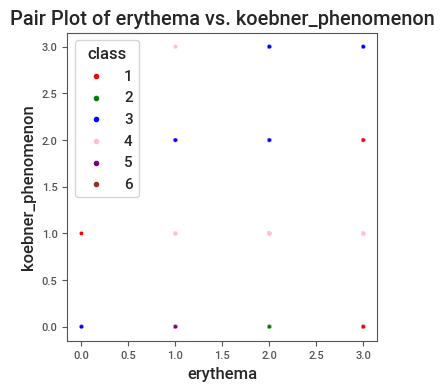

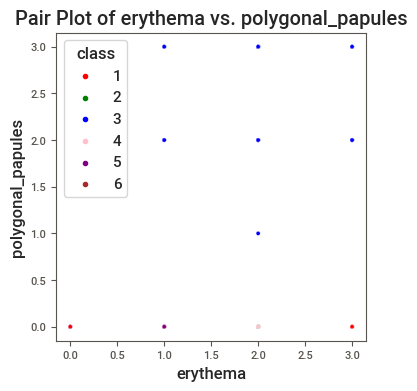

...

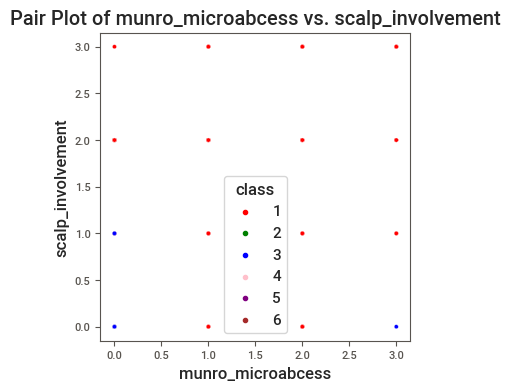

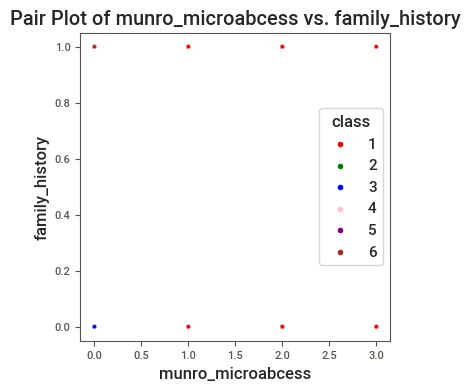

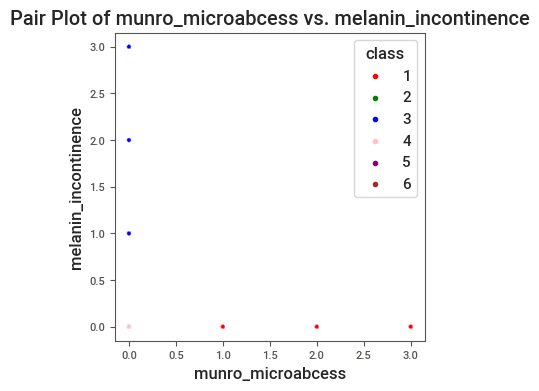

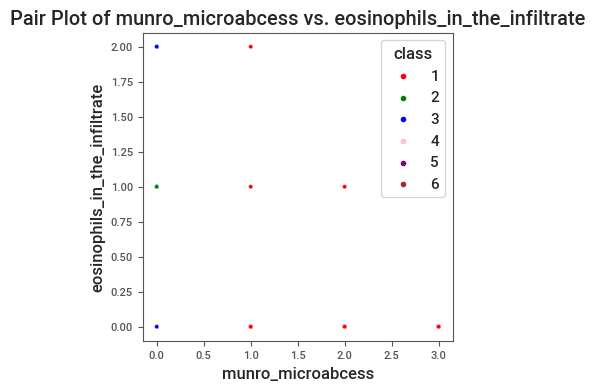

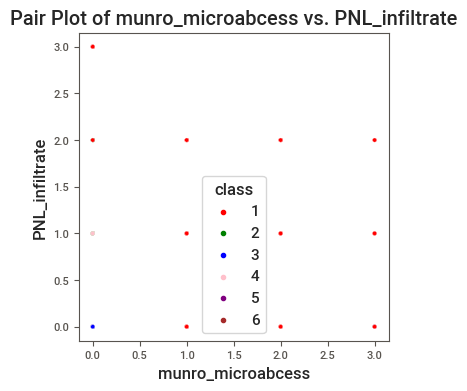

KeyboardInterrupt: 

In [20]:
palette1= ["red","green","blue","pink","purple","brown"]
columns = df.columns

for i in range(len(columns)):
    for j in range(len(columns)):
        if i != j:
            plt.figure(figsize=(4,4))  # Adjust the figure size as needed
            sns.scatterplot(data=df, x=columns[i], y=columns[j], hue="class", palette=palette1)
            plt.title(f"Pair Plot of {columns[i]} vs. {columns[j]}")
            plt.show()

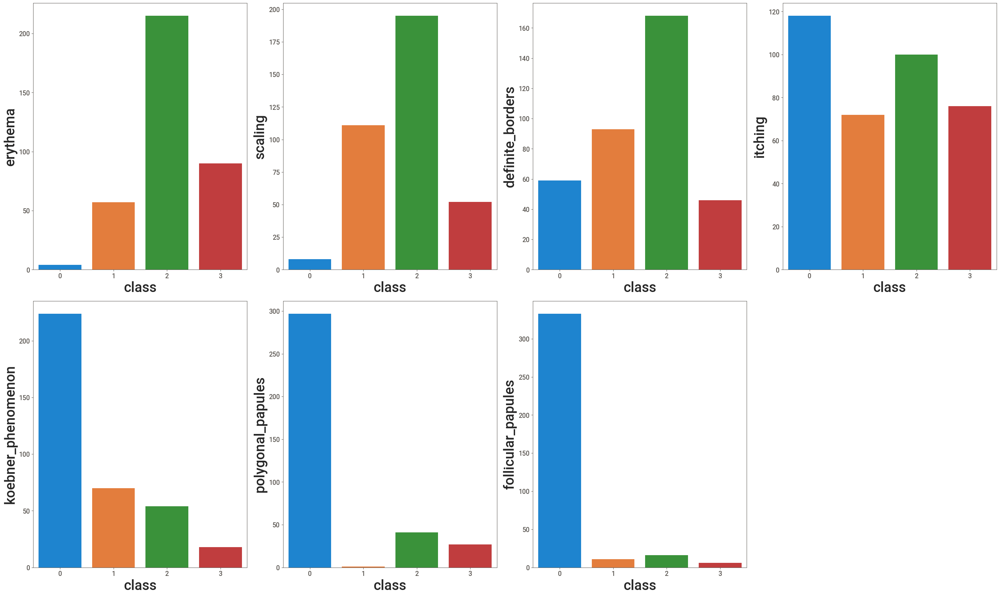

In [70]:
plt.figure(figsize=(30,35), facecolor='white')
plotnumber = 1

for column in df1:
    if plotnumber<=7 :
        ax = plt.subplot(4,4,plotnumber)
        sns.countplot(x=df1[column])
        plt.xlabel('degree',fontsize=30)
        plt.ylabel(column,fontsize=30)
        ax.tick_params(labelsize=14)

    plotnumber+=1
plt.tight_layout()

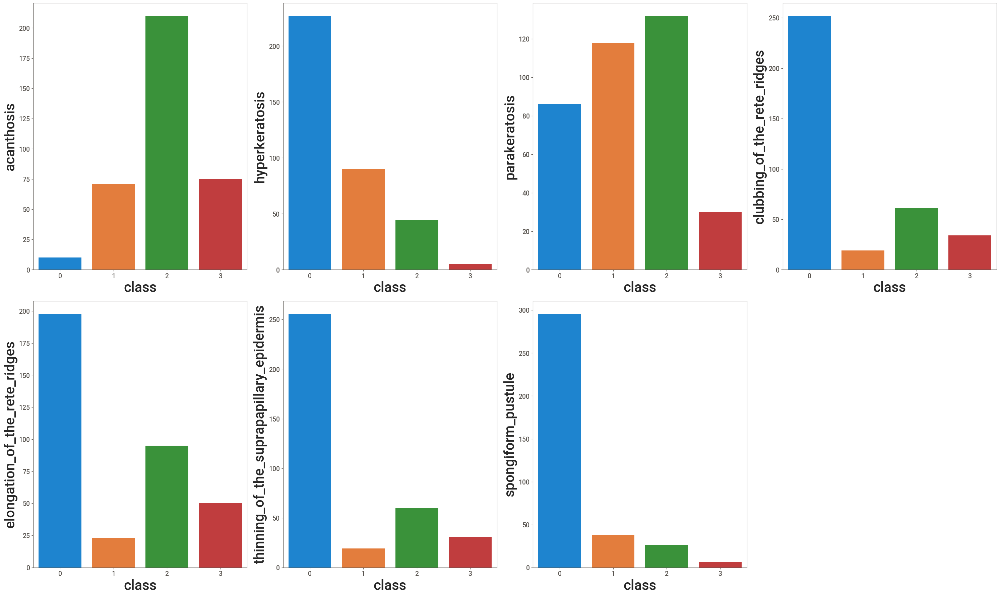

In [30]:
plt.figure(figsize=(30,35), facecolor='white')
plotnumber = 1

for column in df2:
    if plotnumber<=7 :
        ax = plt.subplot(4,4,plotnumber)
        sns.countplot(x=df2[column])
        plt.xlabel('class',fontsize=30)
        plt.ylabel(column,fontsize=30)
        ax.tick_params(labelsize=14)

    plotnumber+=1
plt.tight_layout()

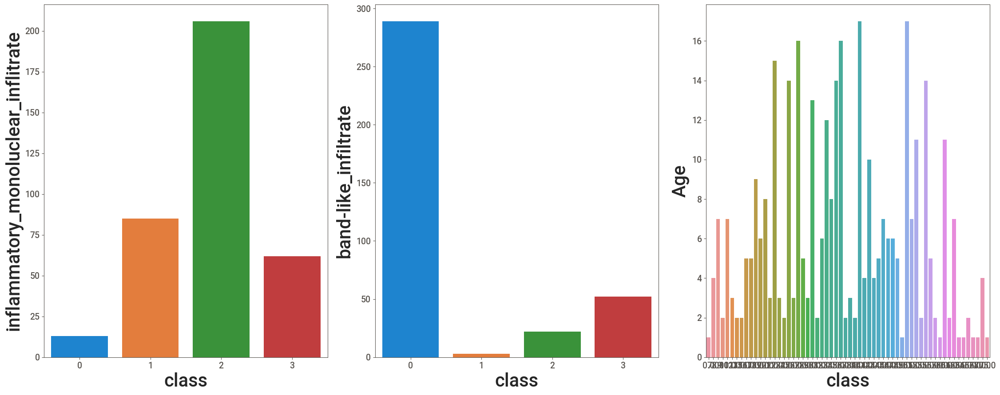

In [31]:
plt.figure(figsize=(30,35), facecolor='white')
plotnumber = 1

for column in df3:
    if plotnumber<=7 :
        ax = plt.subplot(4,4,plotnumber)
        sns.countplot(x=df3[column])
        plt.xlabel('class',fontsize=30)
        plt.ylabel(column,fontsize=30)
        ax.tick_params(labelsize=14)

    plotnumber+=1
plt.tight_layout()

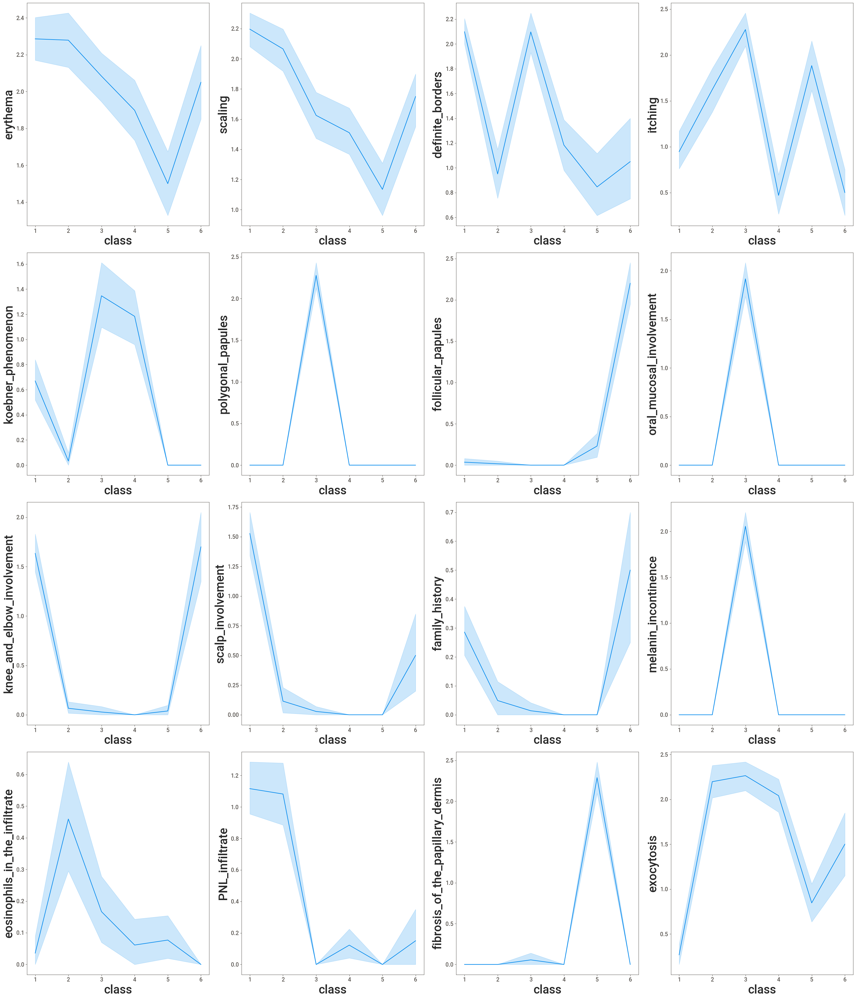

In [32]:
plt.figure(figsize=(30,35), facecolor='white')
plotnumber = 1

for column in df1:
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.lineplot(x=df['class'], y=df1[column])
        plt.xlabel('class',fontsize=30)
        plt.ylabel(column,fontsize=30)
        ax.tick_params(labelsize=14)

    plotnumber+=1
plt.tight_layout()

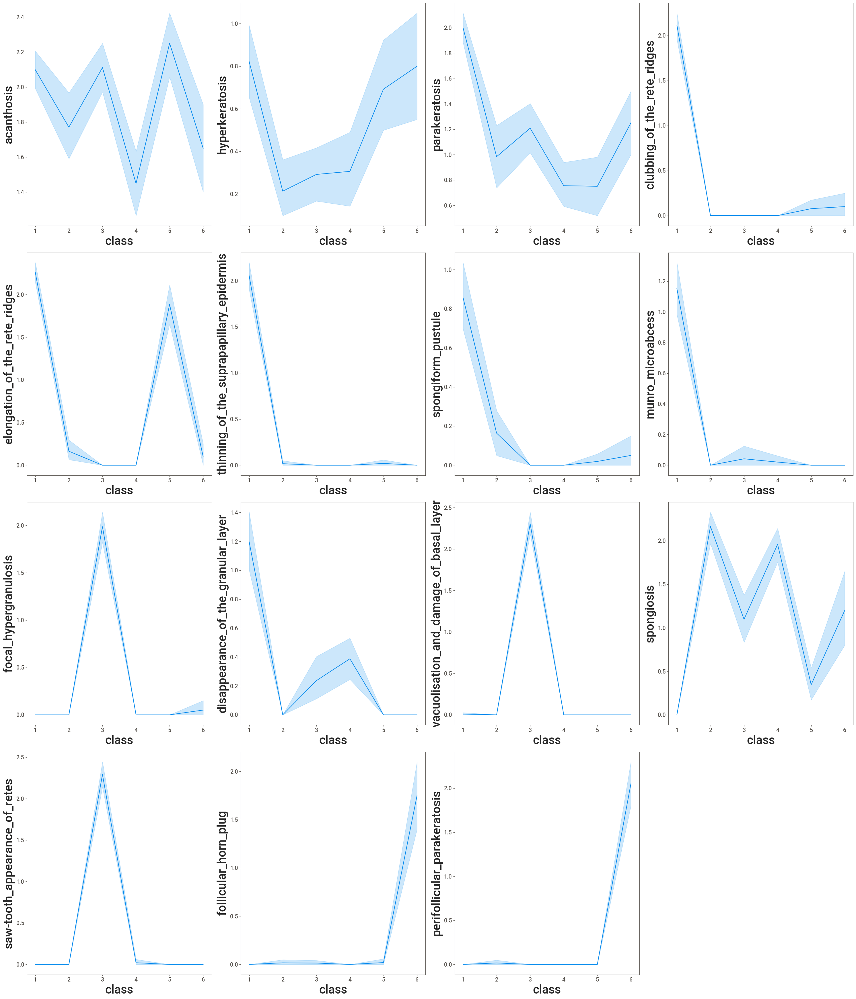

In [33]:
plt.figure(figsize=(30,35), facecolor='white')
plotnumber = 1

for column in df2:
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.lineplot(x=df['class'], y=df2[column])
        plt.xlabel('class',fontsize=30)
        plt.ylabel(column,fontsize=30)
        ax.tick_params(labelsize=14)

    plotnumber+=1
plt.tight_layout()

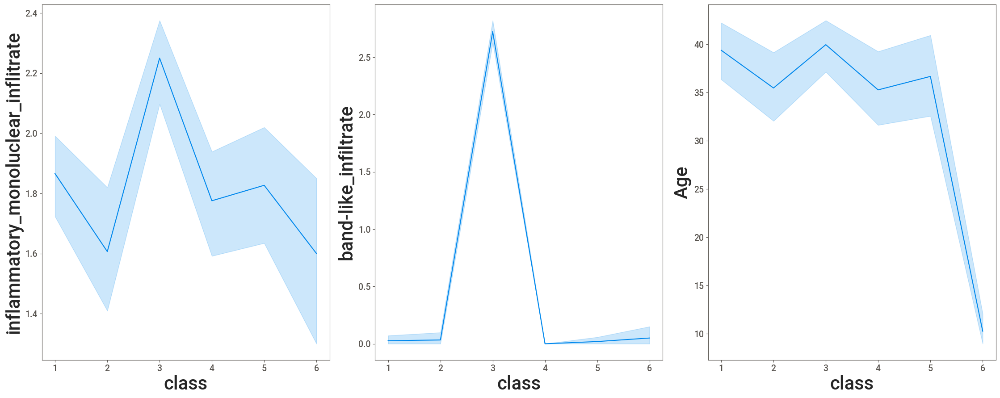

In [34]:
plt.figure(figsize=(30,35), facecolor='white')
plotnumber = 1

for column in df3:
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.lineplot(x=df['class'], y=df3[column])
        plt.xlabel('class',fontsize=30)
        plt.ylabel(column,fontsize=30)
        ax.tick_params(labelsize=14)

    plotnumber+=1
plt.tight_layout()

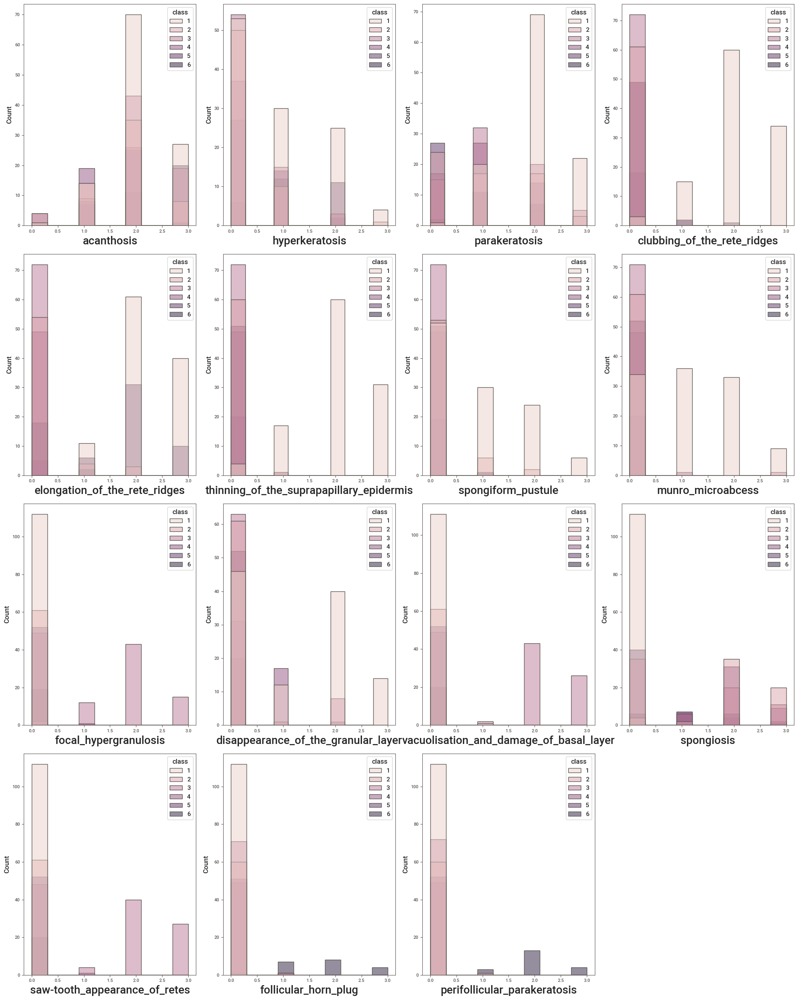

In [48]:
plt.figure(figsize=(20,25), facecolor='white')#To set canvas 
plotnumber = 1

for column in df2:#accessing the columns 
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.histplot(x=df2[column],hue=df['class'])
        plt.xlabel(column,fontsize=20)
        #plt.ylabel('class',fontsize=20)
    plotnumber+=1#counter increment
plt.tight_layout()

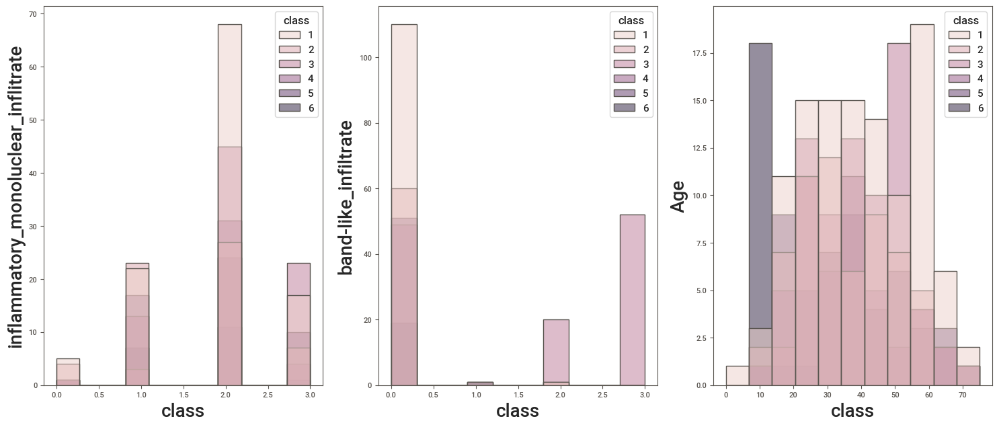

In [46]:
plt.figure(figsize=(20,25), facecolor='white')#To set canvas 
plotnumber = 1

for column in df3:#accessing the columns 
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.histplot(x=df3[column],hue=df['class'])
        plt.xlabel("class",fontsize=20)
        plt.ylabel(column,fontsize=20)
    plotnumber+=1#counter increment
plt.tight_layout()

### Insights from Bivariate Analysis

-erythema is highest in class 1 and 2 and lowest in class 5.

-definite borders are highest in dieases class 1 and 3 and lowest in disease class 2 and 5.

-scaling is highest in class 1 and 2 and lowest in class 5.

-itching  is highest in class 3 and lowest in class 4 and 6.

-koebner phenomenon is highest in class 2,5,6 and lowest in 3 and 4.

-polygonal papules exists only for dieases class 3. for all other categories, it doesnt occur.

-follicular papules exists high intensity in 6 and low intensity in class 5. In others, it doesn't exists. 

-oral mucosal involvement exists only for dieases class 3. for all other categories, it doesnt occur.

-knee and elbow involvement exists for 1 and 6. For others, it is not seen or is very marginal.

-scalp involvement involvement exists for class 1 only. For others, it is not seen or is very marginal.

-melanin incontinence is seen only in dieases class 3.

-eosinophils_in_the_infiltrate is highest in class 2 and marginal to non existent in class 1 and 2.

-PNL_infiltrat is intermediate in class 1 and 2. It is marginal in 3 and 5. 

-fibrosis_of_the_papillary_dermis only exists in diease class 5. For others, it is non existent. 

-exocytosis is highest in class 3 and lowest in class 1.

-acanthosis exists in all classes but highest is in class 5.

-hyperkeratosis exists in range 0 to 1 in all 6 classes.

-parakeratosis is highest in class 2. In all other, it exists in intermediate level.

-clubbing_of_the_rete_ridges is only seen in class 1 and very marginal in class 5 and 6.

-elongation_of_the_rete_ridges is highest in class 1 and 5 and very marginal to non existent in other classes.

-thinning_of_the_suprapapillary_epidermis exists in class 1 and non existent in other classes.

-spongiform_pustule doesnt exists in class 3 and 4 and very marginal in other classes.

-munro_microabcess exists only in class 1 and very marginal to non existent in other classes.

-focal_hypergranulosis only exist in class 3 and is very marginal in 6. in other classes, not existent.

-disappearance of the granular layer doesn't exists in 2,5,6.

-vacuolisation_and_damage_of_basal_layer exists only in 3 and in all other doesn't exists.

-spongiosis is lowest in class 5. In all others, it exists from 1 to 2 in range.

-tooth_appearance_of_retes only exist in class 3 and  in other classes, not existent.

-follicular_horn_plug only exist in class 6 and  in other classes, not existent.

-perifollicular_parakeratosis only exist in class 6 and  in other classes, not existent.

-inflammatory_monoluclear_inflitrate is highest in class 3 and in all other classes exist in intermediate level.

-band-like_infiltrate only exists in class 3 in all other classes marginal to non existent. 

-Age- Disease classes 1 to 5 exists in 35 to 40 years age group. Disease class 6 is mostly seen in younger people aged 10 years or so.



# Data Preprocessing

### Checking null values

In [21]:
df.isnull().sum()

erythema                                    0
scaling                                     0
definite_borders                            0
itching                                     0
koebner_phenomenon                          0
polygonal_papules                           0
follicular_papules                          0
oral_mucosal_involvement                    0
knee_and_elbow_involvement                  0
scalp_involvement                           0
family_history                              0
melanin_incontinence                        0
eosinophils_in_the_infiltrate               0
PNL_infiltrate                              0
fibrosis_of_the_papillary_dermis            0
exocytosis                                  0
acanthosis                                  0
hyperkeratosis                              0
parakeratosis                               0
clubbing_of_the_rete_ridges                 0
elongation_of_the_rete_ridges               0
thinning_of_the_suprapapillary_epi

In [22]:
df.Age.value_counts()

40.0    17
50.0    17
27.0    16
36.0    16
22.0    15
55.0    14
25.0    14
35.0    14
30.0    13
33.0    12
60.0    11
52.0    11
42.0    10
18.0     9
20.0     8
34.0     8
10.0     7
8.0      7
62.0     7
45.0     7
51.0     7
46.0     6
47.0     6
32.0     6
19.0     6
28.0     5
44.0     5
56.0     5
17.0     5
48.0     5
16.0     5
70.0     4
7.0      4
43.0     4
41.0     4
26.0     3
21.0     3
29.0     3
38.0     3
23.0     3
12.0     3
13.0     2
65.0     2
9.0      2
24.0     2
53.0     2
15.0     2
61.0     2
37.0     2
57.0     2
39.0     2
31.0     2
67.0     1
0.0      1
64.0     1
58.0     1
49.0     1
63.0     1
68.0     1
75.0     1
Name: Age, dtype: int64

In [23]:
mean_age = df['Age'].mean()

print("Mean Age:", mean_age)

Mean Age: 36.29608938547486


In [24]:
#replacing null value in Age column with mean Age
df['Age'].fillna(36, inplace=True)

In [25]:
df.Age.isnull().sum()

0

### Checking for duplicates

In [26]:
df.duplicated().sum() 


0

There are no duplicates in the given dataset

### Checking for Outliers

All the columns have values from 0 to 3, only "Age" column has variable values

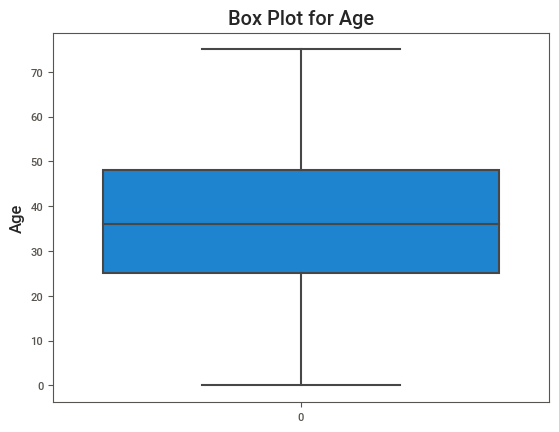

In [27]:
sns.boxplot(data=df["Age"])
plt.ylabel('Age')
plt.title('Box Plot for Age')
plt.show()

There are no outliers in Age column

Also encoding is not required as the given data set is already encoded

### Scaling Data

Since all columns are from 0 to 3 , i.e. they are ordinal features, we dont need to scale them. We will only scale Age column

In [28]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

# Fit the scaler to the data and transform it
scaled_age = scaler.fit_transform(df[['Age']])

# Replace the original 'Age' column with the scaled data
df['Age'] = scaled_age

print(df)

     erythema  scaling  definite_borders  itching  koebner_phenomenon  \
0           2        2                 0        3                   0   
1           3        3                 3        2                   1   
2           2        1                 2        3                   1   
3           2        2                 2        0                   0   
4           2        3                 2        2                   2   
..        ...      ...               ...      ...                 ...   
361         2        1                 1        0                   1   
362         3        2                 1        0                   1   
363         3        2                 2        2                   3   
364         2        1                 3        1                   2   
365         3        2                 2        0                   0   

     polygonal_papules  follicular_papules  oral_mucosal_involvement  \
0                    0                   0         

In [29]:
df.family_history.value_counts()

0    320
1     46
Name: family_history, dtype: int64

# Feature Selection

In [33]:
df.corr()

,erythema,scaling,definite_borders,itching,koebner_phenomenon,polygonal_papules,follicular_papules,oral_mucosal_involvement,knee_and_elbow_involvement,scalp_involvement,...,disappearance_of_the_granular_layer,vacuolisation_and_damage_of_basal_layer,spongiosis,saw-tooth_appearance_of_retes,follicular_horn_plug,perifollicular_parakeratosis,inflammatory_monoluclear_inflitrate,band-like_infiltrate,Age,class
erythema,1.000000,0.435467,0.260087,-0.047623,0.000694,0.033571,-0.109550,-0.026810,0.141008,0.186684,...,0.159100,0.002559,0.022468,-0.005779,-0.005450,0.009539,0.075758,-0.006955,-0.004688,-0.335537
scaling,0.435467,1.000000,0.357987,-0.084197,-0.010576,-0.075035,-0.092400,-0.082969,0.298398,0.301577,...,0.211484,-0.109523,0.012151,-0.114467,-0.010518,-0.011135,-0.010977,-0.132079,0.016162,-0.468688
definite_borders,0.260087,0.357987,1.000000,-0.062564,0.241342,0.327754,-0.166662,0.286684,0.302309,0.268862,...,0.354768,0.298095,-0.255536,0.274576,-0.086250,-0.123947,0.111882,0.282578,0.136404,-0.391974
itching,-0.047623,-0.084197,-0.062564,1.000000,0.267878,0.409696,-0.144825,0.359163,-0.299645,-0.155639,...,-0.192684,0.367650,0.017514,0.376186,-0.175866,-0.184074,0.062781,0.386691,0.047196,0.054772
koebner_phenomenon,0.000694,-0.010576,0.241342,0.267878,1.000000,0.394108,-0.172741,0.392554,-0.066372,0.015202,...,0.004327,0.376473,-0.005938,0.381687,-0.147955,-0.164364,0.083358,0.382844,0.080392,-0.091323
polygonal_papules,0.033571,-0.075035,0.327754,0.409696,0.394108,1.000000,-0.137093,0.865142,-0.276058,-0.253234,...,-0.119698,0.911626,0.080063,0.895107,-0.095477,-0.110204,0.228426,0.905822,0.095831,0.057785
follicular_papules,-0.109550,-0.092400,-0.166662,-0.144825,-0.172741,-0.137093,1.000000,-0.132394,0.222255,-0.003535,...,-0.157296,-0.139960,-0.013454,-0.139141,0.785282,0.844929,-0.084864,-0.133871,-0.370886,0.477813
oral_mucosal_involvement,-0.026810,-0.082969,0.286684,0.359163,0.392554,0.865142,-0.132394,1.000000,-0.283466,-0.259813,...,-0.106704,0.887552,0.120344,0.875209,-0.082601,-0.106426,0.250937,0.892341,0.110315,0.055805
knee_and_elbow_involvement,0.141008,0.298398,0.302309,-0.299645,-0.066372,-0.276058,0.222255,-0.283466,1.000000,0.659206,...,0.481743,-0.282151,-0.413200,-0.280395,0.232903,0.257661,-0.068621,-0.276711,-0.077821,-0.383305
scalp_involvement,0.186684,0.301577,0.268862,-0.155639,0.015202,-0.253234,-0.003535,-0.259813,0.659206,1.000000,...,0.488804,-0.252483,-0.420718,-0.257210,-0.051894,-0.017352,0.035152,-0.249975,0.036523,-0.533208


<Axes: >

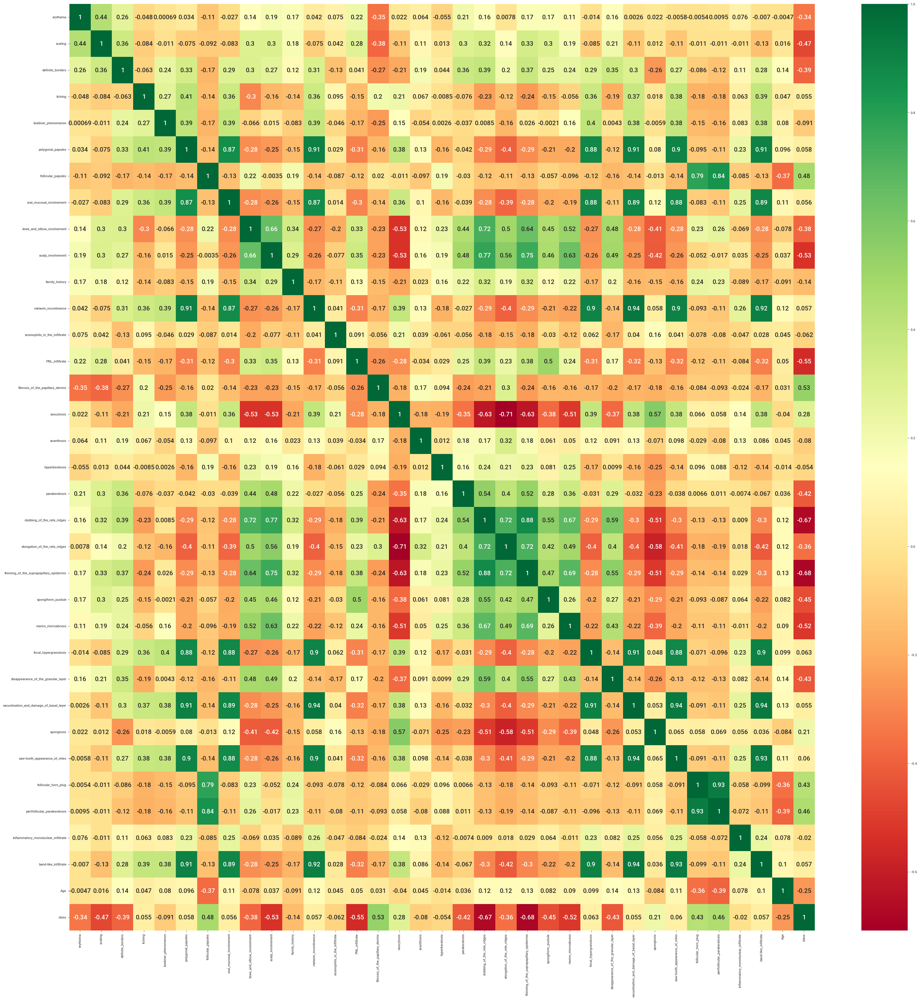

In [34]:
# checking correlation between target and predictors
plt.figure(figsize=(40, 40))
sns.heatmap(df.corr(), annot=True, cmap="RdYlGn", annot_kws={"size":15})